## Preparación del ambiente

In [2]:
import pandas as pd
import numpy as np
import csv
import pandas_profiling as pp

## Con datos extraidos de Producción el 20220905, resumen
1. 2022 Ok, faltan en Referencia 20220628, 29 y 30
2. 2019 no está cargado en Referencia
3. 2019 08 no tiene regs en vw_SoiTablero Producción
4. 20201113 no tiene regs en Referencia
5. Hay diferencias en las cifras de los días 2020 08 13, 2020 10 21 y 2020 12 01 comparando entre Producción y Referencia (146 regs); auncuando hay 81 registros en los que las planillas sí coinciden y los demás no
6. Hay diferencias en las cifras de los días 2021 09 02, 2021 12 06 y 2021 12 07 comparando entre Producción y Referencia (168 regs); auncuando hay 58 registros en los que las planillas sí coinciden y los demás no


### To Do
[ ]    
[ ]    
[ ]    

## Carga de archivos de Producción y Referencia

### Cargar archivo Producción

In [3]:
prod_file = 'vw_SoiTablero-Prod.csv'
base_dir = '../data/ast-ae/'
file = 'prod.csv'

raw = []
with open(base_dir+raw_file) as f:
    r = csv.reader(f, quotechar='"', delimiter='|')
    for row in r:
        raw.append( [x.replace("\n"," ") for x in row] )

with open(base_dir+file, "w", newline="") as f:
    w = csv.writer(f, quotechar='"', quoting=csv.QUOTE_ALL)
    w.writerows(raw)


In [4]:
prod = pd.read_csv(base_dir+prod_file, delimiter=',')
prod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48057 entries, 0 to 48056
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   String                     48057 non-null  object 
 1   OperadorDispersionesTop    48057 non-null  object 
 2   OperadorPlanillasTop       48057 non-null  object 
 3   OperadorRegistrosTop       48057 non-null  object 
 4   Periodo                    48057 non-null  int64  
 5   Fecha                      48057 non-null  object 
 6   Categoria                  48057 non-null  object 
 7   CodigoOperadorInformacion  48057 non-null  int64  
 8   OperadorInformacion        48057 non-null  object 
 9   CodigoCanal                48057 non-null  int64  
 10  Canal                      48057 non-null  object 
 11  OperadorPila               48057 non-null  object 
 12  Dispersiones               48057 non-null  float64
 13  Planillas                  48057 non-null  flo

In [5]:
#prod['Fecha'] = pd.to_datetime(prod['Fecha'].dt.strftime('%Y-%m-%d'))
prod['Fecha'] = pd.to_datetime(prod['Fecha'])

In [6]:
prod = prod[['String','Periodo','Fecha','Categoria','CodigoOperadorInformacion','CodigoCanal','OperadorPila','Dispersiones',\
    'Planillas','Registros','Valor']]

In [7]:
prod[(prod.String.str[:5] == '43545')]

,String,Periodo,Fecha,Categoria,CodigoOperadorInformacion,CodigoCanal,OperadorPila,Dispersiones,Planillas,Registros,Valor
38,43545SOI8215SOI,201903,2019-03-21,SOI,82,15,SOI,150.000,39.000,656,"105.523.800,00"
852,43545SOI5615SOI,201903,2019-03-21,SOI,56,15,SOI,7.000,4.000,8,"1.819.400,00"
1968,43545SOI6015SOI,201903,2019-03-21,SOI,60,15,SOI,27.000,4.000,95,"6.057.800,00"
2154,43545SOI915SOI,201903,2019-03-21,SOI,9,15,SOI,237.000,63.000,1.253,"575.800.800,00"
2639,43545SOI6615SOI,201903,2019-03-21,SOI,66,15,SOI,74.000,6.000,3.581,"293.665.600,00"
...,...,...,...,...,...,...,...,...,...,...,...
44748,43545OTROS OPERADORES841APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,1,APORTES EN LÍNEA,5.339,2.180,12.527,"712.510.917,00"
44839,43545OTROS OPERADORES841APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,1,APORTES EN LÍNEA,18.206,8.179,33.038,"2.053.765.788,00"
45653,43545OTROS OPERADORES8412APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,12,APORTES EN LÍNEA,86.000,35.000,180,"9.253.200,00"
46467,43545OTROS OPERADORES8419APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,19,APORTES EN LÍNEA,2.055,1.045,2.664,"159.526.700,00"


In [8]:
prod.columns = [x.replace(x, 'Prod_'+ x) for x in prod.columns]

In [9]:
prod[(prod.Prod_String.str[:5] == '43545')]

,Prod_String,Prod_Periodo,Prod_Fecha,Prod_Categoria,Prod_CodigoOperadorInformacion,Prod_CodigoCanal,Prod_OperadorPila,Prod_Dispersiones,Prod_Planillas,Prod_Registros,Prod_Valor
38,43545SOI8215SOI,201903,2019-03-21,SOI,82,15,SOI,150.000,39.000,656,"105.523.800,00"
852,43545SOI5615SOI,201903,2019-03-21,SOI,56,15,SOI,7.000,4.000,8,"1.819.400,00"
1968,43545SOI6015SOI,201903,2019-03-21,SOI,60,15,SOI,27.000,4.000,95,"6.057.800,00"
2154,43545SOI915SOI,201903,2019-03-21,SOI,9,15,SOI,237.000,63.000,1.253,"575.800.800,00"
2639,43545SOI6615SOI,201903,2019-03-21,SOI,66,15,SOI,74.000,6.000,3.581,"293.665.600,00"
...,...,...,...,...,...,...,...,...,...,...,...
44748,43545OTROS OPERADORES841APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,1,APORTES EN LÍNEA,5.339,2.180,12.527,"712.510.917,00"
44839,43545OTROS OPERADORES841APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,1,APORTES EN LÍNEA,18.206,8.179,33.038,"2.053.765.788,00"
45653,43545OTROS OPERADORES8412APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,12,APORTES EN LÍNEA,86.000,35.000,180,"9.253.200,00"
46467,43545OTROS OPERADORES8419APORTES EN LÍNEA,201903,2019-03-21,OTROS OPERADORES,84,19,APORTES EN LÍNEA,2.055,1.045,2.664,"159.526.700,00"


In [10]:
prod[(prod.Prod_String.str[:5] == '43545') & (prod.Prod_Periodo != 201903)]

,Prod_String,Prod_Periodo,Prod_Fecha,Prod_Categoria,Prod_CodigoOperadorInformacion,Prod_CodigoCanal,Prod_OperadorPila,Prod_Dispersiones,Prod_Planillas,Prod_Registros,Prod_Valor


In [11]:
prod.head().T

,0,1,2,3,4
Prod_String,43887SOI8215SOI,43790SOI8215SOI,44704SOI8215SOI,43543SOI8215SOI,43873SOI8215SOI
Prod_Periodo,202002,201911,202205,201903,202002
Prod_Fecha,2020-02-26 00:00:00,2019-11-21 00:00:00,2022-05-23 00:00:00,2019-03-19 00:00:00,2020-02-12 00:00:00
Prod_Categoria,SOI,SOI,SOI,SOI,SOI
Prod_CodigoOperadorInformacion,82,82,82,82,82
Prod_CodigoCanal,15,15,15,15,15
Prod_OperadorPila,SOI,SOI,SOI,SOI,SOI
Prod_Dispersiones,92.0,110.0,214.0,212.0,195.0
Prod_Planillas,31.0,27.0,88.0,45.0,51.0
Prod_Registros,147,442,433,2.705,390


In [12]:
prod.describe()

,Prod_Periodo,Prod_CodigoOperadorInformacion,Prod_CodigoCanal,Prod_Dispersiones,Prod_Planillas
count,48057.000000,48057.000000,48057.000000,48057.000000,48057.000000
mean,202033.801007,53.993799,10.418357,156.366370,143.510917
std,102.369991,33.309857,6.397792,244.470967,218.700157
min,201901.000000,1.000000,1.000000,1.000000,1.000000
25%,201911.000000,19.000000,1.000000,5.000000,6.163000
50%,202009.000000,60.000000,13.000000,34.000000,26.000000
75%,202108.000000,84.000000,15.000000,190.000000,205.000000
max,202206.000000,89.000000,99.000000,999.000000,999.000000


In [42]:
include_list=['object']
prod.describe(include=include_list)

,Prod_String,Prod_Categoria,Prod_OperadorPila,Prod_Registros,Prod_Valor
count,48057,48057,48057,48057,48057
unique,47726,3,7,17613,46561
top,43545OTROS OPERADORES891ARUS,SOI,SOI,2,"113.600,00"
freq,2,27324,28138,402,77


### Encontrar registros duplicados
La condición de duplicado está dada por el campo ``Prod_String`` (Concatenación de Fecha - Categoría - CodigoOperadorInformacion - CodigoCanal - OperadorPila)

In [43]:
prod.Prod_String.value_counts()

43545OTROS OPERADORES891ARUS                 2
43500OTROS OPERADORES861ASOPAGOS             2
43479OTROS OPERADORES861ASOPAGOS             2
43496OTROS OPERADORES891ARUS                 2
43516OTROS OPERADORES871FEDECAJAS            2
                                            ..
44735SOI61SOI                                1
44616SOI61SOI                                1
43550SOI61SOI                                1
43907SOI61SOI                                1
43718OTROS OPERADORES8413APORTES EN LÍNEA    1
Name: Prod_String, Length: 47726, dtype: int64

In [44]:
#[prod.groupby(['Prod_String']).count()][(Prod_Periodo > 1)]
prod_grp =(prod.groupby(['Prod_String']).count())
prod_grp[(prod_grp.Prod_Periodo > 1)]

,Prod_Periodo,Prod_Fecha,Prod_Categoria,Prod_CodigoOperadorInformacion,Prod_CodigoCanal,Prod_OperadorPila,Prod_Dispersiones,Prod_Planillas,Prod_Registros,Prod_Valor
Prod_String,,,,,,,,,,
43467OTROS OPERADORES831MI PLANILLA,2,2,2,2,2,2,2,2,2,2
43467OTROS OPERADORES841APORTES EN LÍNEA,2,2,2,2,2,2,2,2,2,2
43467OTROS OPERADORES861ASOPAGOS,2,2,2,2,2,2,2,2,2,2
43467OTROS OPERADORES871FEDECAJAS,2,2,2,2,2,2,2,2,2,2
43467OTROS OPERADORES881SIMPLE,2,2,2,2,2,2,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...
43545OTROS OPERADORES861ASOPAGOS,2,2,2,2,2,2,2,2,2,2
43545OTROS OPERADORES871FEDECAJAS,2,2,2,2,2,2,2,2,2,2
43545OTROS OPERADORES881SIMPLE,2,2,2,2,2,2,2,2,2,2


In [45]:
prod_grp.reset_index(inplace=True)
prod_grp = prod_grp.rename(columns = {'index':'Prod_String'})

In [47]:
prod_dupl = prod_grp[(prod_grp.Prod_Periodo > 1)]

In [48]:
prod_dupl.describe()

,Prod_Periodo,Prod_Fecha,Prod_Categoria,Prod_CodigoOperadorInformacion,Prod_CodigoCanal,Prod_OperadorPila,Prod_Dispersiones,Prod_Planillas,Prod_Registros,Prod_Valor
count,331.0,331.0,331.0,331.0,331.0,331.0,331.0,331.0,331.0,331.0
mean,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
25%,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
50%,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
75%,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
max,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0


In [49]:
prod_dupl.columns

Index(['Prod_String', 'Prod_Periodo', 'Prod_Fecha', 'Prod_Categoria',
       'Prod_CodigoOperadorInformacion', 'Prod_CodigoCanal',
       'Prod_OperadorPila', 'Prod_Dispersiones', 'Prod_Planillas',
       'Prod_Registros', 'Prod_Valor'],
      dtype='object')

In [53]:
# df['New_Sample'] = df.Sample.str[:1]
prod_dupl['Prod_SoloFecha'] = prod_dupl.Prod_String.str[:5]

C:\Users\carlo\AppData\Local\Temp\ipykernel_15668\3634647589.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prod_dupl['Prod_SoloFecha'] = prod_dupl.Prod_String.str[:5]


In [55]:
prod_dupl.head().T

,4,9,12,17,21
Prod_String,43467OTROS OPERADORES831MI PLANILLA,43467OTROS OPERADORES841APORTES EN LÍNEA,43467OTROS OPERADORES861ASOPAGOS,43467OTROS OPERADORES871FEDECAJAS,43467OTROS OPERADORES881SIMPLE
Prod_Periodo,2,2,2,2,2
Prod_Fecha,2,2,2,2,2
Prod_Categoria,2,2,2,2,2
Prod_CodigoOperadorInformacion,2,2,2,2,2
Prod_CodigoCanal,2,2,2,2,2
Prod_OperadorPila,2,2,2,2,2
Prod_Dispersiones,2,2,2,2,2
Prod_Planillas,2,2,2,2,2
Prod_Registros,2,2,2,2,2


In [60]:
prod_dupl[(prod_grp.Prod_Periodo == 201902)].T

C:\Users\carlo\AppData\Local\Temp\ipykernel_15668\1859088389.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prod_dupl[(prod_grp.Prod_Periodo == 201902)].T


""
Prod_String
Prod_Periodo
Prod_Fecha
Prod_Categoria
Prod_CodigoOperadorInformacion
Prod_CodigoCanal
Prod_OperadorPila
Prod_Dispersiones
Prod_Planillas
Prod_Registros


In [61]:
prod.loc[48052]

Prod_String                       44063OTROS OPERADORES8413APORTES EN LÍNEA
Prod_Periodo                                                         202008
Prod_Fecha                                              2020-08-20 00:00:00
Prod_Categoria                                             OTROS OPERADORES
Prod_CodigoOperadorInformacion                                           84
Prod_CodigoCanal                                                         13
Prod_OperadorPila                                          APORTES EN LÍNEA
Prod_Dispersiones                                                     5.177
Prod_Planillas                                                         2.43
Prod_Registros                                                        6.959
Prod_Valor                                                   495.060.900,00
Name: 48052, dtype: object

In [62]:
prod.iloc[48052]

Prod_String                       44063OTROS OPERADORES8413APORTES EN LÍNEA
Prod_Periodo                                                         202008
Prod_Fecha                                              2020-08-20 00:00:00
Prod_Categoria                                             OTROS OPERADORES
Prod_CodigoOperadorInformacion                                           84
Prod_CodigoCanal                                                         13
Prod_OperadorPila                                          APORTES EN LÍNEA
Prod_Dispersiones                                                     5.177
Prod_Planillas                                                         2.43
Prod_Registros                                                        6.959
Prod_Valor                                                   495.060.900,00
Name: 48052, dtype: object

### Cargar archivo Referencia

In [21]:
ref_file = 'vw_SoiTablero-Ref.csv'
base_dir = '../data/ast-ae/'

raw = []
with open(base_dir+raw_file) as f:
    r = csv.reader(f, quotechar='"', delimiter='|')
    for row in r:
        raw.append( [x.replace("\n"," ") for x in row] )

with open(base_dir+file, "w", newline="") as f:
    w = csv.writer(f, quotechar='"', quoting=csv.QUOTE_ALL)
    w.writerows(raw)


In [22]:
ref = pd.read_csv(base_dir+ref_file, delimiter=',')
ref.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34962 entries, 0 to 34961
Data columns (total 16 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   String                     34962 non-null  object 
 1   Periodo                    34962 non-null  int64  
 2   Fecha                      34962 non-null  object 
 3   Categoria                  34962 non-null  object 
 4   CodigoOperadorInformacion  34962 non-null  int64  
 5   OperadorInformacion        34962 non-null  object 
 6   CodigoCanal                34962 non-null  int64  
 7   Canal                      34962 non-null  object 
 8   Dispersiones               34962 non-null  float64
 9   Planillas                  34962 non-null  float64
 10  Registros                  34962 non-null  object 
 11  Valor                      34962 non-null  object 
 12  OperadorDispersionesTop    34962 non-null  object 
 13  OperadorPlanillasTop       34962 non-null  obj

In [23]:
ref['Fecha'] = pd.to_datetime(ref['Fecha'])

In [24]:
ref = ref[['String','Periodo','Fecha','Categoria','CodigoOperadorInformacion','CodigoCanal','OperadorPila','Dispersiones',\
    'Planillas','Registros','Valor']]

In [25]:
ref.columns = [x.replace(x, 'Ref_'+ x) for x in ref.columns]

In [26]:
ref.head().T

,0,1,2,3,4
Ref_String,44019SOI8215SOI,44034SOI8215SOI,44025SOI8215SOI,44041SOI8215SOI,44020SOI8215SOI
Ref_Periodo,202007,202007,202007,202007,202007
Ref_Fecha,2020-07-07 00:00:00,2020-07-22 00:00:00,2020-07-13 00:00:00,2020-07-29 00:00:00,2020-07-08 00:00:00
Ref_Categoria,SOI,SOI,SOI,SOI,SOI
Ref_CodigoOperadorInformacion,82,82,82,82,82
Ref_CodigoCanal,15,15,15,15,15
Ref_OperadorPila,SOI,SOI,SOI,SOI,SOI
Ref_Dispersiones,438.0,115.0,452.0,196.0,337.0
Ref_Planillas,88.0,37.0,117.0,43.0,91.0
Ref_Registros,9.893,183,6.746,1.279,792


In [27]:
ref.describe()

,Ref_Periodo,Ref_CodigoOperadorInformacion,Ref_CodigoCanal,Ref_Dispersiones,Ref_Planillas
count,34962.000000,34962.000000,34962.000000,34962.000000,34962.000000
mean,202084.419913,53.321521,10.504805,160.800353,143.711144
std,73.402939,33.355846,6.357983,250.668572,216.748377
min,202001.000000,1.000000,1.000000,1.000000,1.000000
25%,202008.000000,19.000000,1.000000,5.389500,6.469250
50%,202103.000000,56.000000,13.000000,34.000000,24.063000
75%,202111.000000,84.000000,15.000000,196.000000,217.000000
max,202206.000000,89.000000,20.000000,999.000000,999.000000


In [28]:
include_list=['object']
ref.describe(include=include_list)

,Ref_String,Ref_Categoria,Ref_OperadorPila,Ref_Registros,Ref_Valor
count,34962,34962,34962,34962,34962
unique,34962,3,7,13913,33909
top,44019SOI8215SOI,SOI,SOI,2,"113.600,00"
freq,1,20252,20858,313,77


In [29]:
ref.Ref_String.value_counts()

44019SOI8215SOI                         1
44379OTROS OPERADORES8615ASOPAGOS       1
44371OTROS OPERADORES8615ASOPAGOS       1
44372OTROS OPERADORES8615ASOPAGOS       1
44375OTROS OPERADORES8615ASOPAGOS       1
                                       ..
43971SOI71SOI                           1
43958SOI71SOI                           1
43957SOI71SOI                           1
43972SOI71SOI                           1
44736OTROS OPERADORES8315MI PLANILLA    1
Name: Ref_String, Length: 34962, dtype: int64

## Merge

In [77]:
# Como hay duplicados el merge falla
pd.merge(prod, ref, how='outer', on=['Prod_String', 'Ref_String'])

KeyError: 'Prod_String'

---

### Profiling: Creo que no aporta

In [31]:
pp.ProfileReport(pcd)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
pcd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   INSTRUCTIONID             99 non-null     int64  
 1   PAYMENTID                 99 non-null     object 
 2   ORIGINALPAYMENTREFERENCE  99 non-null     int64  
 3   PAYMENTTYPE               99 non-null     int64  
 4   SETTLEMENTREFERENCE       99 non-null     object 
 5   TRA_PHONE                 99 non-null     int64  
 6   CA_CLEARINGSCHEMEID       99 non-null     int64  
 7   C_ACCOUNT                 99 non-null     int64  
 8   AMOUNT                    99 non-null     int64  
 9   D_PARTYID                 99 non-null     object 
 10  C_CLEARINGSCHEMEID        99 non-null     int64  
 11  C_NAME                    99 non-null     object 
 12  PIA_NAME                  99 non-null     object 
 13  RECEIVEDDATE              99 non-null     object 
 14  VALUEDATE   

### Todos los registros corresponden a transacciones con estado (**`STATUS`**) 'DELETED'

In [119]:
pcd.STATUS.unique()

array(['DELETED'], dtype=object)

In [120]:
pcd['STATUS'].value_counts()

DELETED    99
Name: STATUS, dtype: int64

In [121]:
pcd.head(3).T

,0,1,2
INSTRUCTIONID,103523,103523,103523
PAYMENTID,be4e21db-01aa-4cf3-801d-ebd2bccb1a6c,5056d8f7-37c4-4414-b291-2c3c7c62210a,d0c71a3e-2a95-45e3-85c7-7e40ebb7cfc2
ORIGINALPAYMENTREFERENCE,10095089514,10095089515,10095089516
PAYMENTTYPE,32,32,32
SETTLEMENTREFERENCE,20220705-1,20220705-1,20220705-1
TRA_PHONE,29258945,29258945,29258945
CA_CLEARINGSCHEMEID,1052,1013,1032
C_ACCOUNT,615719130,21273933,24114139788
AMOUNT,88661,6700,62532
D_PARTYID,BANCITIBAN,BANCITIBAN,BANCITIBAN


### Validaciones con campo ```TASKSTATUS```

Hay dos valores cambiantes en el JSON.   
1. El "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES" cuyo valor se repite en el campo UD_ACCOUNTTYPE y está contenido en el campo ORIGINALPAYMENTREFERENCE
2. El valor "recordDelim", el cual no se encuentra en ningún otro campo del registro

In [20]:
pcd['TASKSTATUS'].loc[1]

'{     "AdendaCredito":[         {             "TIPO DE REGISTRO":"7",             "CODIGO TIPO DE REGISTRO ADENDA":"05",             "IDENTIFICACION CLIENTE ORIGINADOR":"000004444449824",             "RESERVADO":"  ",             "PROPOSITO DE LA TRANSACCION":"TRASLADOS ",             "REFERENCIA DEL PAGO":"000000000000000000000000  000000000000000000000000   ",             "NUMERO DE SECUENCIA DE REGISTRO DE ADENDA":"0001",             "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES":"5089515",             "FILLER8":"            ",             "recordDelim":"1564"         }     ] }'

In [21]:
pcd['TASKSTATUS'].loc[2]

'{     "AdendaCredito":[         {             "TIPO DE REGISTRO":"7",             "CODIGO TIPO DE REGISTRO ADENDA":"05",             "IDENTIFICACION CLIENTE ORIGINADOR":"000004444449824",             "RESERVADO":"  ",             "PROPOSITO DE LA TRANSACCION":"TRASLADOS ",             "REFERENCIA DEL PAGO":"000000000000000000000000  000000000000000000000000   ",             "NUMERO DE SECUENCIA DE REGISTRO DE ADENDA":"0001",             "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES":"5089516",             "FILLER8":"            ",             "recordDelim":"1566"         }     ] }'

In [22]:
pcd['TASKSTATUS'].loc[3]

'{     "AdendaCredito":[         {             "TIPO DE REGISTRO":"7",             "CODIGO TIPO DE REGISTRO ADENDA":"05",             "IDENTIFICACION CLIENTE ORIGINADOR":"000004444449824",             "RESERVADO":"  ",             "PROPOSITO DE LA TRANSACCION":"TRASLADOS ",             "REFERENCIA DEL PAGO":"000000000000000000000000  000000000000000000000000   ",             "NUMERO DE SECUENCIA DE REGISTRO DE ADENDA":"0001",             "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES":"5089517",             "FILLER8":"            ",             "recordDelim":"1568"         }     ] }'

### Validaciones con AMOUNT, C_ACCOUNT, RECEIVEDDATE - VALUEDATE

In [32]:
pcd['AMOUNT'].value_counts()

88661     1
91275     1
78745     1
5473      1
837969    1
         ..
445776    1
322992    1
27258     1
15706     1
126700    1
Name: AMOUNT, Length: 99, dtype: int64

In [33]:
pcd['C_ACCOUNT'].value_counts()

615719130       1
1860011459      1
24079207012     1
648619062       1
488405535417    1
               ..
3024282251      1
48612437141     1
24111408409     1
49253017910     1
144371648       1
Name: C_ACCOUNT, Length: 99, dtype: int64

In [36]:
pcd[(pcd.RECEIVEDDATE != pcd.VALUEDATE)].count()

INSTRUCTIONID               99
PAYMENTID                   99
ORIGINALPAYMENTREFERENCE    99
PAYMENTTYPE                 99
SETTLEMENTREFERENCE         99
TRA_PHONE                   99
CA_CLEARINGSCHEMEID         99
C_ACCOUNT                   99
AMOUNT                      99
D_PARTYID                   99
C_CLEARINGSCHEMEID          99
C_NAME                      99
PIA_NAME                    99
RECEIVEDDATE                99
VALUEDATE                   99
IDRA_ADDRESS                99
ORIGMSGSUBFUNCTION           0
BATCHID                     99
STATUS                      99
D_NAME                      99
IA1_NAME                    99
IRA_EMAIL                   99
ORIGINALSERVICELEVEL        99
IDRA_EMAIL                  99
ORIGINALVALUEDATE           99
UC_PHONE                     0
UNSTRUCTUREDPAYMENTINFO     99
UC_NAME                      0
UNIQUEMANDATEREFERENCE       0
C_ACCOUNTTYPE               99
TASKSTATUS                  99
dtype: int64

In [37]:
pcd[['RECEIVEDDATE','VALUEDATE']]

,RECEIVEDDATE,VALUEDATE
0,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
1,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
2,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
3,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
4,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
...,...,...
94,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
95,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
96,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
97,05-JUL-22 09.50.25.721000000 PM,05-JUL-22


## Análisis de la muestra de datos de INSTRUCTIONRAWDATA

### Crear archivo copia para poder abrirlo en excel
Remover los saltos de línea en los campos json

In [2]:
raw_file = 'instructionrawdata.csv'
base_dir = '../data/ast-hp/'
file = 'ird.csv'

In [3]:
raw = []
with open(base_dir+raw_file) as f:
    r = csv.reader(f, quotechar='"', delimiter='|')
    for row in r:
        raw.append( [x.replace("\n"," ") for x in row] )

with open(base_dir+file, "w", newline="") as f:
    w = csv.writer(f, quotechar='"', quoting=csv.QUOTE_ALL, delimiter='|')
    w.writerows(raw)

In [4]:
raw = pd.read_csv(base_dir+raw_file, delimiter='|')
raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 61 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   INSTRUCTIONID                   99 non-null     int64  
 1   ENTRYDATE                       99 non-null     object 
 2   FILESTATUS                      99 non-null     object 
 3   TOTAL_NUMBER_OF_PAYMENTS        98 non-null     float64
 4   PAYMENTSCOMPLETED               98 non-null     float64
 5   PAYMENTSREJECTED                98 non-null     float64
 6   PAYMENTSPENDING                 98 non-null     float64
 7   FILEPROCESSINGSERVER            99 non-null     object 
 8   FILEHASH                        0 non-null      float64
 9   FIELDHASH                       0 non-null      float64
 10  DESCRIPTION                     98 non-null     object 
 11  OPTIMIZEDSTORAGE                98 non-null     float64
 12  ISDATACOMPUTATION               0 non-

In [5]:
raw.TRANSPORTINFO.head(1).T

0    {\n    "TransportType":"UPLOAD",\n    "Transpo...
Name: TRANSPORTINFO, dtype: object

### Profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

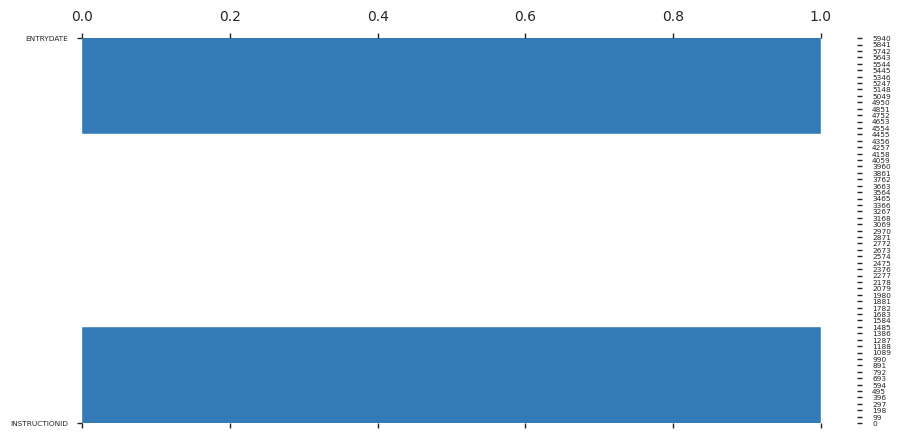

In [8]:
pp.ProfileReport(raw)

In [12]:
ird = raw [['ENTRYDATE', 'TRANSPORTNAME', 'ORIGINAL_FINANCIAL_ENTITY_NAME', 'TOTAL_NUMBER_OF_PAYMENTS', 'PAYMENTSCOMPLETED', 'PAYMENTSREJECTED', 'DEBIT_VALUE', 'CREDIT_VALUE', 'INSTRUCTIONID', \
    'FILESTATUS', 'PAYMENTSPENDING', 'DESCRIPTION', 'TRANSPORTTYPE', 'TRANSPORTINFO', 'INPUTREFERENCECODE', 'PARTYCODE', 'SERVICECODE', 'SOURCEREFERENCECODE', 'BATCHESRECEIVED', \
    'BATCHESCOMPLETED', 'CREDIT_VALUE', 'CYCLE', 'FILENAME', \
    'VALUEDEBITSORIGINALFILE', 'VALUECREDITSORIGINALFILE', 'VALUEDEBITSDONOTREQUIREAUTH', 'VALUEAUTHORIZEDDEBITS', 'VALUEDEBITSPROCESSED', 'VALUECREDITSREQUIREAUTH', 'VALUECREDITSDONOTREQUIREAUTH', \
    'VALUEAUTHORIZEDCREDITS', 'VALUECREDITSPROCESSED' ]]


In [15]:
ird.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 32 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   ENTRYDATE                       99 non-null     object 
 1   TRANSPORTNAME                   98 non-null     object 
 2   ORIGINAL_FINANCIAL_ENTITY_NAME  54 non-null     object 
 3   TOTAL_NUMBER_OF_PAYMENTS        98 non-null     float64
 4   PAYMENTSCOMPLETED               98 non-null     float64
 5   PAYMENTSREJECTED                98 non-null     float64
 6   DEBIT_VALUE                     54 non-null     float64
 7   CREDIT_VALUE                    54 non-null     float64
 8   INSTRUCTIONID                   99 non-null     int64  
 9   FILESTATUS                      99 non-null     object 
 10  PAYMENTSPENDING                 98 non-null     float64
 11  DESCRIPTION                     98 non-null     object 
 12  TRANSPORTTYPE                   99 non

In [18]:
# ird sin 'CREDIT_VALUE'
ird = raw [['ENTRYDATE', 'TRANSPORTNAME', 'ORIGINAL_FINANCIAL_ENTITY_NAME', 'TOTAL_NUMBER_OF_PAYMENTS', 'PAYMENTSCOMPLETED', 'PAYMENTSREJECTED', 'DEBIT_VALUE', 'INSTRUCTIONID', \
    'FILESTATUS', 'PAYMENTSPENDING', 'DESCRIPTION', 'TRANSPORTTYPE', 'TRANSPORTINFO', 'INPUTREFERENCECODE', 'PARTYCODE', 'SERVICECODE', 'SOURCEREFERENCECODE', 'BATCHESRECEIVED', \
    'BATCHESCOMPLETED', 'CREDIT_VALUE', 'CYCLE', 'FILENAME', \
    'VALUEDEBITSORIGINALFILE', 'VALUECREDITSORIGINALFILE', 'VALUEDEBITSDONOTREQUIREAUTH', 'VALUEAUTHORIZEDDEBITS', 'VALUEDEBITSPROCESSED', 'VALUECREDITSREQUIREAUTH', 'VALUECREDITSDONOTREQUIREAUTH', \
    'VALUEAUTHORIZEDCREDITS', 'VALUECREDITSPROCESSED' ]]
pp.ProfileReport(ird)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
ird[['FILESTATUS']].value_counts()

FILESTATUS
REJECTED      53
COMPLETED     45
DELETED        1
dtype: int64

In [18]:
ird[(ird.FILESTATUS != 'REJECTED')].head(5).T

,14,18,19,23,31
ENTRYDATE,05-JUL-22 11.54.29.337000000 PM,06-JUL-22 12.34.55.348000000 AM,06-JUL-22 12.56.02.268000000 AM,06-JUL-22 12.59.40.940000000 AM,06-JUL-22 03.23.07.185000000 PM
TRANSPORTNAME,0001009.002.1.env,0001009.001.1.env,0001007.028.1.env,0001001.002.1.env,0001001.001.1.env
ORIGINAL_FINANCIAL_ENTITY_NAME,CITIBANK,CITIBANK,BANCOLOMBIA,BOGOTA,BOGOTA
TOTAL_NUMBER_OF_PAYMENTS,1980.0,88492.0,159357.0,48609.0,1702.0
PAYMENTSCOMPLETED,591.0,88484.0,159350.0,48607.0,1702.0
PAYMENTSREJECTED,1389.0,8.0,7.0,2.0,0.0
DEBIT_VALUE,0.0,0.0,11619742430.01,154279715.32,274710254.0
CREDIT_VALUE,6265055805.16,152670847709.459991,675253139438.180054,274050445600.48999,902622042.13
INSTRUCTIONID,104221,104222,104561,104562,106602
FILESTATUS,COMPLETED,COMPLETED,COMPLETED,COMPLETED,COMPLETED
